# Dependencies

In [ ]:
import os

import numpy as np
import scipy.io
from PIL import Image

%matplotlib inline
import plotly
from matplotlib import pyplot as plt
from plotly.graph_objs import Bar, Layout, Scatter
from plotly.graph_objs.layout import XAxis, YAxis
from scipy import ndimage as ndi
from skimage.filters import gabor_kernel
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error


# Business Understanding

# Data Preparation

## Read images
- Read in your images as numpy arrays. Resize and recolor images as necessary. 

In [2]:
# classpaths
dataset_path = "oxfordflower17/jpg"
label_file = "oxfordflower17/imagelabels.mat"

# Get sorted image filenames
image_files = sorted(os.listdir(dataset_path))
image_files = [f for f in image_files if f.endswith(".jpg")]

image_arrays = []

# Read in your images as numpy arrays, Resize and recolor images.
for file in image_files:
    img_path = os.path.join(dataset_path, file)
    img = Image.open(img_path).convert("RGB")
    # Resize image
    img = img.resize((128, 128))
    # Read images as numpy arrays
    img_array = np.array(img)

    image_arrays.append(img_array)

# Convert list to NumPy array
image_arrays = np.array(image_arrays)

labels_data = scipy.io.loadmat(label_file)

# get labels--y
y = labels_data["labels"][0]


n_samples, h, w, ch = image_arrays.shape
n_classes = len(np.unique(y))

print("Image dataset shape:", image_arrays.shape)
print(np.sum(~np.isfinite(image_arrays)))
print(f"n_samples: {n_samples}")
print(f"n_features: {h * w * ch}")
print(f"n_classes: {n_classes}")
print(f"Original Image Sizes {h} by {w}")


Image dataset shape: (1360, 128, 128, 3)
0
n_samples: 1360
n_features: 49152
n_classes: 17
Original Image Sizes 128 by 128


## Linearize the images
- Linearize the images to create a table of 1-D image features (each row should be one image).  
- The origina dataset does not contains the label name. To better understand the label name, we preprosse it. 

In [3]:
X = image_arrays.reshape(image_arrays.shape[0], -1)
print("Flattened image dataset shape:", X.shape)

# Attach Labels to the Feature Table
dataset_with_labels = np.column_stack((X, y))

# Print the new dataset shape
print("Final dataset shape (features + label):", dataset_with_labels.shape)

category_names = {
    1: "Daffodil",
    2: "Snowdrop",
    3: "Lily Valley",
    4: "Bluebell",
    5: "Crocus",
    6: "Iris",
    7: "Tigerlily",
    8: "Tulip",
    9: "Fritillary",
    10: "Sunflower",
    11: "Daisy",
    12: "Coltsfoot",
    13: "Dandelion",
    14: "Cowslip",
    15: "Buttercup",
    16: "Windflower",
    17: "Pansy",
}

names = np.array([category_names[label] for label in y])

print("First 10 flower names:", names[:10])


Flattened image dataset shape: (1360, 49152)
Final dataset shape (features + label): (1360, 49153)
First 10 flower names: ['Daffodil' 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil'
 'Daffodil' 'Daffodil' 'Daffodil' 'Daffodil']


## Visualize several images.

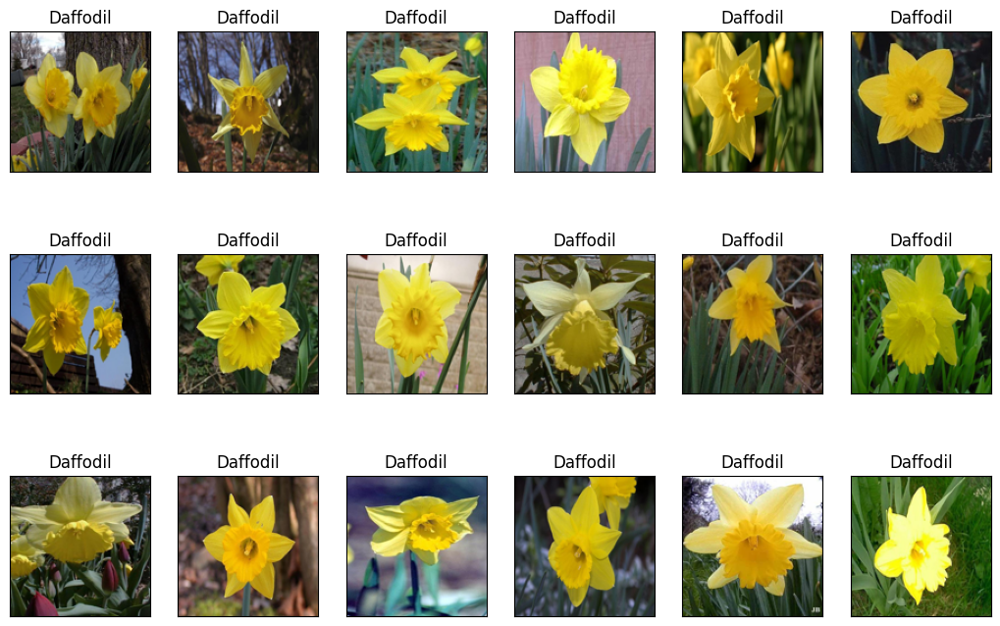

In [4]:
# a helper plotting function
def plot_gallery(images, titles, h, w, ch, n_row=3, n_col=6):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.7 * n_col, 2.3 * n_row))
    plt.subplots_adjust(
        bottom=0,
        left=0.01,
        right=0.99,
        top=0.90,
        hspace=0.35,
    )
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w, ch)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())


plot_gallery(
    X,
    names,
    h,
    w,
    ch,
)  # defaults to showing a 3 by 6 subset of the faces
plt.show()

# Data Reduction 

## Dimensionality Reduction Using Full PCA

In [5]:
# lets do some PCA of the features and go from 1850 features to 500 features
n_components = 500
print(
    "Extracting the top %d eigenfaces from %d faces"
    % (n_components, X.shape[0]),
)

pca = PCA(n_components=n_components)
%time pca.fit(X.copy())
eigenfaces = pca.components_.reshape((n_components, h, w, ch))

Extracting the top 500 eigenfaces from 1360 faces
CPU times: user 9.05 s, sys: 1.01 s, total: 10.1 s
Wall time: 8.57 s


In [6]:
# manipulated from Sebastian Raschka Example (your book!)
# also from blog here: http://sebastianraschka.com/Articles/2015_pca_in_3_steps.html

# this is a scree plot
def plot_explained_variance(pca):
    plotly.offline.init_notebook_mode()  # run at the start of every notebook

    explained_var = pca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)

    plotly.offline.iplot(
        {
            "data": [
                Bar(y=explained_var, name="individual explained variance"),
                Scatter(
                    y=cum_var_exp,
                    name="cumulative explained variance",
                ),
            ],
            "layout": Layout(
                xaxis=XAxis(title="Principal components"),
                yaxis=YAxis(title="Explained variance ratio"),
            ),
        },
    )


plot_explained_variance(pca)
pca_variance = np.sum(pca.explained_variance_ratio_)
print(f"Explained Variance with Standard PCA: {pca_variance}")

Explained Variance with Standard PCA: 0.9240003450242602



From the above explained variance plot, we can see:

1. the explained variance ratio increases as the the number of the principal components increases
2. when principal components reaches around 500, the explained variance ratio would be 0.9240200221980395, greater than 90%, meaning 500 principal components have alread capture 90%+ information. This suggest 500 principal components would adequately represent our image data.
3. Therefore, we can set n_components = 500

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0011267658529891026..0.007084972371288301].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.005059610430339614..0.011130768373892388].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.005136125276066058..0.014143616589136205].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.007812839202006542..0.01003483131328779].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008948272310288092..0.01644334434475509].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.012479510793622696..0.014613513207778386].

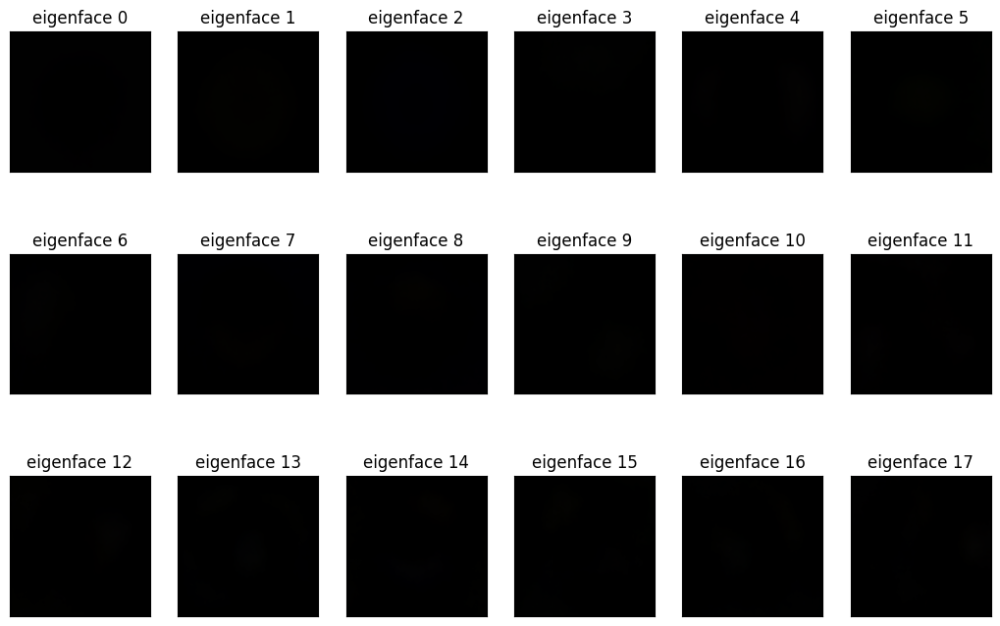

In [7]:
eigenface_titles = ["eigenface %d" % i for i in range(eigenfaces.shape[0])]
plot_gallery(eigenfaces, eigenface_titles, h, w, ch)
plt.show()

### Note
From above visualization, we found that eigenfaces are appearing black. Through research, we found that it is because PCA components contain both positive and negative values, and above imshow() function expects values in the positive range.

Therefore, we need to normalize the PCA components (eigenfaces) to scale values to a valid range([0.0,1.0]) for display, by defining the function normalize_eigenfaces(eigenfaces)

In [8]:
def normalize_eigenfaces(eigenfaces):
    eigenfaces_normalized = (eigenfaces - np.min(eigenfaces)) / (
        np.max(eigenfaces) - np.min(eigenfaces)
    )
    return eigenfaces_normalized

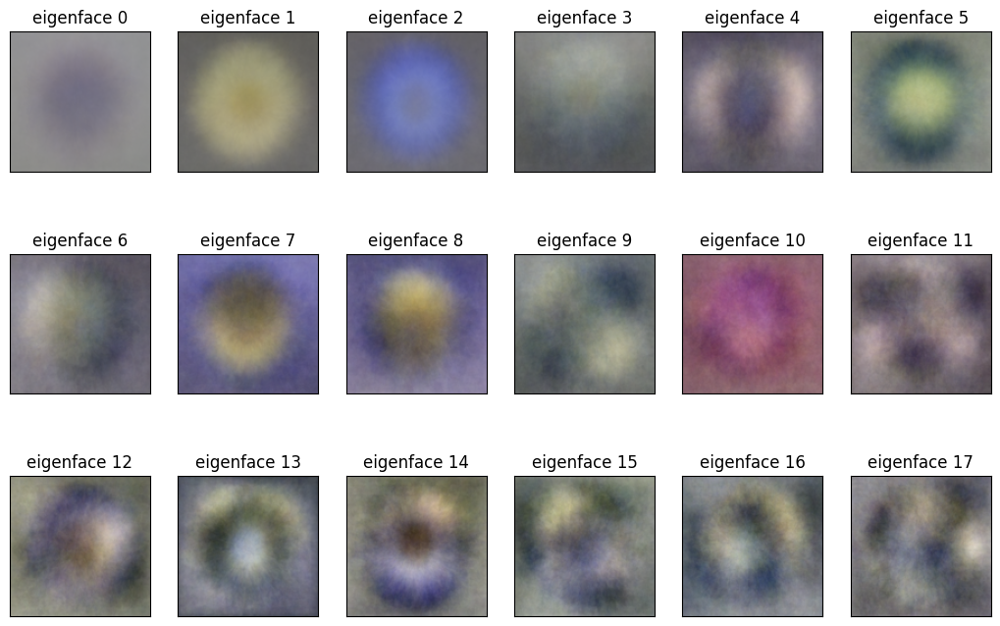

In [9]:
plot_gallery(normalize_eigenfaces(eigenfaces), eigenface_titles, h, w, ch)
plt.show()

In [10]:
def reconstruct_image(trans_obj, org_features):
    low_rep = trans_obj.transform(org_features)
    rec_image = trans_obj.inverse_transform(low_rep)
    return low_rep, rec_image


idx_to_reconstruct = 1
X_idx = X[idx_to_reconstruct]
low_dimensional_representation, reconstructed_image = reconstruct_image(
    pca,
    X_idx.reshape(1, -1),
)

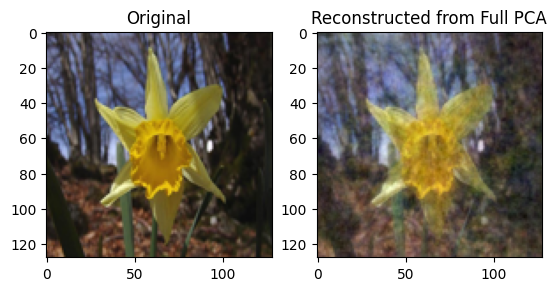

In [11]:
# Reshape reconstructed image back to (h, w, 3)
reconstructed_image_reshape = reconstructed_image.reshape((h, w, ch))

# Normalize for display (optional)

plt.subplot(1, 2, 1)
plt.imshow(X_idx.reshape((h, w, ch)), cmap=plt.cm.gray)
plt.title("Original")
plt.grid(False)
plt.subplot(1, 2, 2)
plt.imshow(normalize_eigenfaces(reconstructed_image_reshape))
plt.title("Reconstructed from Full PCA")
plt.grid(False)
plt.show()

## Dimensionality Reduction Using Randomized PCA

In [12]:
# lets do some PCA of the features and go from 1850 features to 500 features

n_components = 500
print(
    "Extracting the top %d eigenfaces from %d faces"
    % (n_components, X.shape[0]),
)

rpca = PCA(n_components=n_components, svd_solver="randomized")
%time rpca.fit(X.copy())
eigenfaces = rpca.components_.reshape((n_components, h, w, ch))

Extracting the top 500 eigenfaces from 1360 faces
CPU times: user 9.09 s, sys: 1.05 s, total: 10.1 s
Wall time: 8.68 s


In [13]:
plot_explained_variance(rpca)
rand_pca_variance = np.sum(rpca.explained_variance_ratio_)
print(f"Explained Variance with Randomized PCA: {rand_pca_variance}")

Explained Variance with Randomized PCA: 0.9240382377103198


From the above explained variance plot, we can see the trends similiar to the full PCA:

1. the explained variance ratio increases as the the number of the principal components increases
2. when principal components reaches around 500, the explained variance ratio is 0.9239806422583094, greater than 90%, meaning 500 principal components have alread capture 90%+ information. This suggest 500 principal components would adequately represent our image data.
3. Therefore, we can set n_components = 500

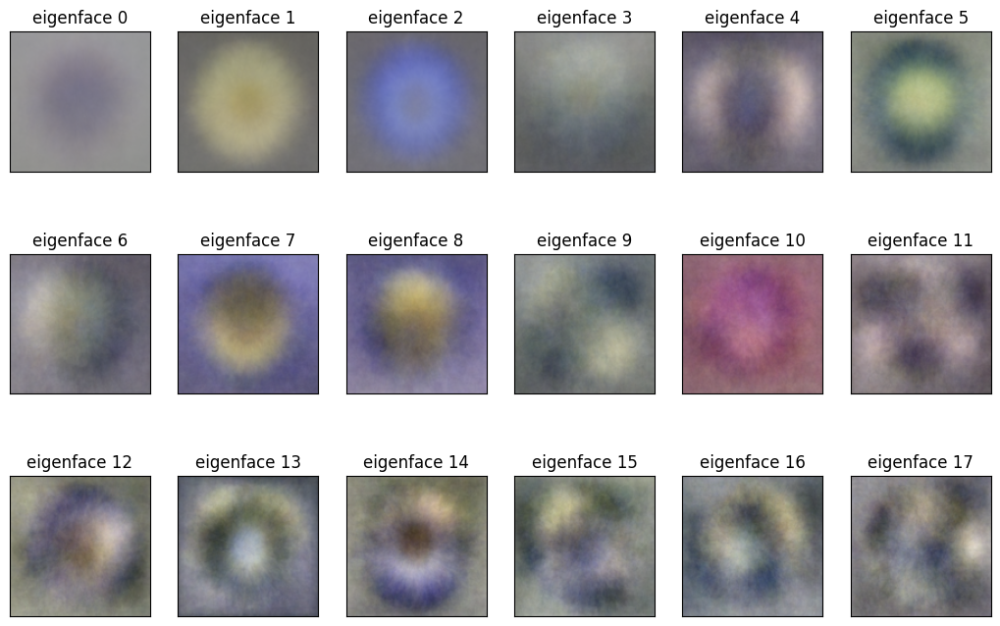

In [14]:
eigenface_titles = ["eigenface %d" % i for i in range(eigenfaces.shape[0])]
plot_gallery(normalize_eigenfaces(eigenfaces), eigenface_titles, h, w, ch)
plt.show()

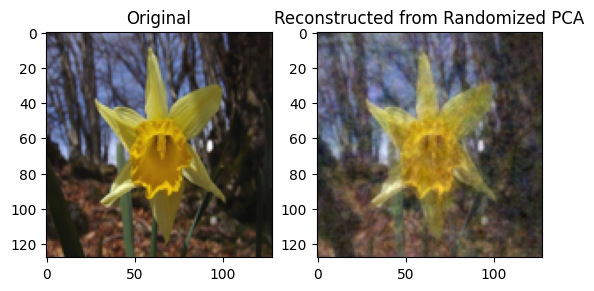

In [15]:
low_dimensional_representation_r, reconstructed_image_r = (
    reconstruct_image(rpca, X_idx.reshape(1, -1))
)

# Reshape reconstructed image back to (h, w, 3)
reconstructed_image_reshape_r = reconstructed_image_r.reshape((h, w, 3))

# Normalize for display (optional)

plt.subplot(1, 2, 1)
plt.imshow(X_idx.reshape((h, w, ch)), cmap=plt.cm.gray)
plt.title("Original")
plt.grid(False)
plt.subplot(1, 2, 2)
plt.imshow(normalize_eigenfaces(reconstructed_image_reshape_r))
plt.title("Reconstructed from Randomized PCA")
plt.grid(False)
plt.show()

## Compare the representation using PCA and Randomized PCA.

To compare Full PCA and Randomized PCA, we can 
1. compare there explained_variance of both two PCA based on the same number of Principal components(n_components=500)
2. Compare Reconstruction Quality

In [16]:
# Compare Explained Variance
print("Explained Variance as follows:")
print(f"Full       PCA: {pca_variance}")
print(f"Randomized PCA: {rand_pca_variance}")
print(
    f"Explained Variance diff(Full PCA-Randomized PCA):  {pca_variance - rand_pca_variance}",
)

# Compare MSE
mse_pca = mean_squared_error(X_idx.reshape(1, -1), reconstructed_image)
mse_rand_pca = mean_squared_error(
    X_idx.reshape(1, -1),
    reconstructed_image_r,
)

print("----------------------------------------------------")
print("MSE as follows:")
print(f"Full       PCA: {mse_pca}")
print(f"Randomized PCA: {mse_rand_pca}")

Explained Variance as follows:
Full       PCA: 0.9240003450242602
Randomized PCA: 0.9240382377103198
Explained Variance diff(Full PCA-Randomized PCA):  -3.789268605958185e-05
----------------------------------------------------
MSE as follows:
Full       PCA: 163.8680986098241
Randomized PCA: 158.44664070855896


## Analysis

From the comparsion regarding Explained Variance and MSE, we can see:
1. The variance of Randomized PCA is just slightly smaller than that of Full PCA(very close), meaning that  Randomized PCA is a good approximation.
2. The MSE of Randomized PCA is lower than that of Full PCA, meaning that  better Randomized PCA have a better reconstruction quality.

## Feature Extraction using Gabor Filters

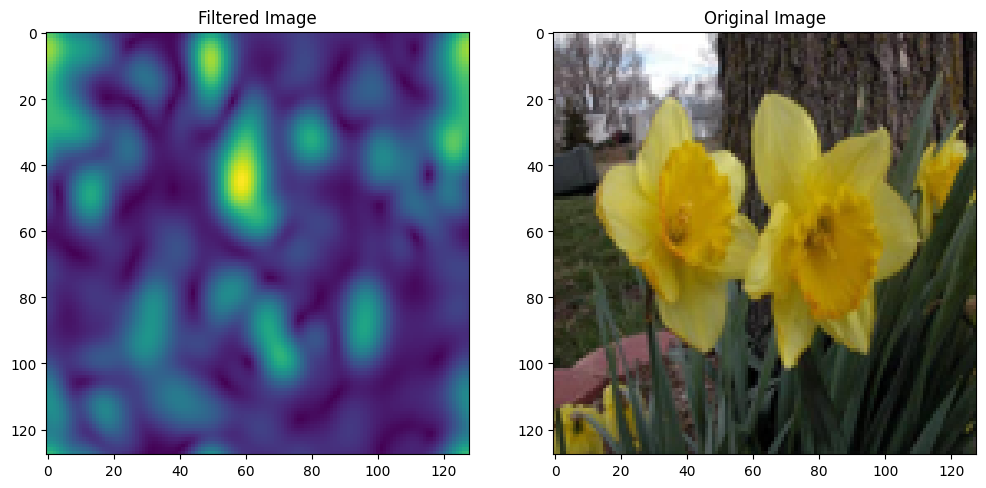

In [ ]:
def compute_gabor_filters(frequencies, thetas):
    """Generates a list of Gabor kernels for specified frequencies and orientations."""
    kernels = []
    for freq in frequencies:
        for theta in thetas:
            kernel = gabor_kernel(freq, theta=theta)
            kernels.append(kernel)
    return kernels


def apply_gabor_filters(image, kernels):
    """Applies a list of Gabor filters to an image."""
    filtered_images = []
    for kernel in kernels:
        filtered_channels = []
        for channel in range(image.shape[2]):
            filtered = ndi.convolve(
                image[:, :, channel], kernel, mode="wrap"
            )
            filtered_channels.append(filtered)
        filtered_images.append(np.stack(filtered_channels, axis=2))
    return np.stack(filtered_images, axis=0)


# Example usage:
frequencies = [0.1, 0.3]
# Orientations from 0 to 180 degrees in steps of 45 degrees
thetas = np.arange(0, np.pi, np.pi / 4)
gabor_kernels = compute_gabor_filters(frequencies, thetas)
filtered_images = apply_gabor_filters(image_arrays[0], gabor_kernels)

# Convert complex values to magnitude
magnitude_images = np.abs(filtered_images)

# filtered_images now contains the result of applying all Gabor filters to the image
# Its shape is (num_kernels, height, width)
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(magnitude_images[0, :, :, 0])
plt.title("Filtered Image")

plt.subplot(1, 2, 2)
plt.imshow(image_arrays[0])
plt.title("Original Image")

plt.show()

### TODO

In [ ]:
## feature extraction analysis

### TODO

# Exceptional Work

### TODO